In [1]:
import time
from pathlib import Path
from pprint import pprint
from statistics import mean, stdev

import matplotlib.pyplot as plt
import numpy as np
import torch
from IPython.display import Audio, display
from scipy.signal import freqz
from torch import Tensor
from torch.utils.data import DataLoader
from tqdm.notebook import tqdm

from src.dataset import SignalTrainDataset, download_signal_train_dataset_to
from src.loss import forge_validation_criterions_by
from src.model import S4ConditionalModel
from src.model.layer import DSSM, convert_to_decibel
from src.parameter import ConditionalTaskParameter
from src.utils import get_tensor_device, set_random_seed_to

# S4 Single-chain Hyper-conditioning Dynamic Range Compressor Model Evaluation

This Jupyter Notebook contains routine to evaluate a trained single-chain S4 DRC model with hyper-conditioning.

Edit and execute the code in the [Preparatory Work](#preparatory-work) section first to load the model,
and then execude the code in the rest of the section to evaluate each individual metrics.

Each individual evaluation task is wrapped in a function to prevent variables going global,
and neither any function saves images to the local file system.

## <a id="preparatory-work">Preparatory Work</a>

Edit the following global constant to locate the model to be evaluated.

If the model is trained properly using my given script, you don't need to edit any other cell.

In [2]:
DATASET_DIR = Path('./data/SignalTrain')

CHECKPOINT_DIR = Path('./experiment-result')
JOB_NAME = '2023-5-10-7-1-39'
EPOCH = 68

TESTING_DATASET_SEGMENT_LENGTH = 10.0
TESTING_DATASET_BATCH_SIZE = 5
TESTING_DATASET_SAMPLE_INDEX = [10, 20, 100, 200, 234]

Execute the following code to load the model and configuration.

In [3]:
job_dir = CHECKPOINT_DIR / JOB_NAME
device = get_tensor_device(apple_silicon=False)  # Some operations are not supported on Apple Silicon
param = ConditionalTaskParameter.from_json(CHECKPOINT_DIR / JOB_NAME / 'config.json')
pprint(param.to_dict())

set_random_seed_to(param.random_seed)

download_signal_train_dataset_to(DATASET_DIR)
testing_dataset = SignalTrainDataset(DATASET_DIR, 'test', TESTING_DATASET_SEGMENT_LENGTH)

model = S4ConditionalModel(
    param.model_take_side_chain,
    param.model_inner_audio_channel,
    param.model_s4_hidden_size,
    param.s4_learning_rate,
    param.model_depth,
    param.model_film_take_batchnorm,
    param.model_take_residual_connection,
    param.model_convert_to_decibels,
    param.model_take_tanh,
    param.model_activation,
).eval().to(device)
model.load_state_dict(torch.load(CHECKPOINT_DIR / JOB_NAME / f'model-epoch-{EPOCH}.pth', map_location=device))

{'batch_size': 64,
 'checkpoint_dir': PosixPath('experiment-result'),
 'data_segment_length': 1.0,
 'dataset_dir': PosixPath('data/SignalTrain'),
 'enable_learning_rate_scheduler': True,
 'epoch': 70,
 'learning_rate': 0.001,
 'log_wandb': True,
 'loss': 'ESR+DC+Multi-STFT',
 'loss_filter_coef': 0.85,
 'model_activation': 'PReLU',
 'model_convert_to_decibels': False,
 'model_depth': 4,
 'model_film_take_batchnorm': True,
 'model_inner_audio_channel': 32,
 'model_s4_hidden_size': 4,
 'model_take_residual_connection': True,
 'model_take_side_chain': True,
 'model_take_tanh': False,
 'random_seed': 42,
 's4_learning_rate': 0.001,
 'save_checkpoint': True,
 'wandb_entity': 'int0thewind',
 'wandb_project_name': 'S4 Dynamic Range Compressor'}
The SignalTrain dataset has been downloaded. Skipping ... 


Loading test dataset.:   0%|          | 0/6 [00:00<?, ?it/s]

<All keys matched successfully>

## LA-2A Envelope Analysis

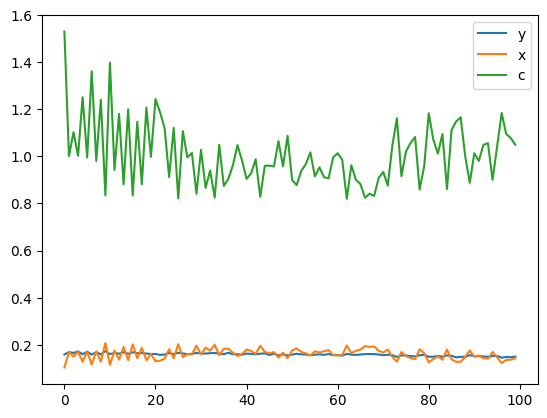

In [4]:
@torch.no_grad()
def envelope_analysis():
    x, y, cond = testing_dataset[TESTING_DATASET_SAMPLE_INDEX[-1]]
    s = slice(4350, 4450)
    x = x[s].detach().cpu().numpy()
    y = y[s].detach().cpu().numpy()
    c = y / x
    fig, ax = plt.subplots()
    ax.plot(y, label='y')
    ax.plot(x, label='x')
    ax.plot(c, label='c')
    handles, lables = ax.get_legend_handles_labels()
    ax.legend(handles, lables)
    fig.show()

envelope_analysis()

## General Testing

In [5]:
@torch.no_grad()
def test():
    print('ESR loss cannot be inferred from CPU. Need to contact Christian to fix it.')
    local_testing_dataset = SignalTrainDataset(DATASET_DIR, 'test', 1.5)
    dataloader = DataLoader(local_testing_dataset, 64)

    validation_criterions = forge_validation_criterions_by(param.loss_filter_coef, device)
    validation_losses = {
        validation_loss: 0.0
        for validation_loss in validation_criterions.keys()
    }

    for x, y, parameters in tqdm(dataloader, desc='Testing', total=len(dataloader)):
        x: Tensor = x.to(device)
        y: Tensor = y.to(device)
        parameters: Tensor = parameters.to(device)

        y_hat: Tensor = model(x, parameters)

        for validation_loss, validation_criterion in validation_criterions.items():
            loss: Tensor = validation_criterion(y_hat.unsqueeze(1), y.unsqueeze(1))
            validation_losses[validation_loss] += loss.item()
    
    for k, v in list(validation_losses.items()):
        validation_losses[k] = v / len(dataloader)
    
    pprint(validation_losses)

test()

ESR loss cannot be inferred from CPU. Need to contact Christian to fix it.


Loading test dataset.:   0%|          | 0/6 [00:00<?, ?it/s]

Testing:   0%|          | 0/29 [00:00<?, ?it/s]

{'DC': 0.0005011151725770544,
 'ESR': 0.1193223736281025,
 'MAE': 0.012477238582254484,
 'MSE': 0.00042134489407983673,
 'Multi-STFT': 0.6789773332661596,
 'STFT': 0.6830668696041765}


## S4 Frequency Response Analysis

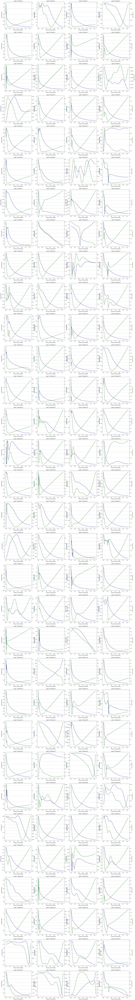

In [6]:
@torch.no_grad()
def s4_frequency_response_analysis():
    col = len(model.blocks)
    row = param.model_inner_audio_channel
    fig, axs = plt.subplots(row, col, figsize=(col * 7, row * 7))
    for c, block in enumerate(model.blocks):
        s4 = block.s4
        assert isinstance(s4, DSSM)
        kernel = s4.get_kernel(int(testing_dataset.sample_rate * 1))
        for r in range(param.model_inner_audio_channel):
            impulse_response = kernel[r, :].detach().cpu().numpy()
            w, h = freqz(impulse_response)
            ax = axs[r][c]
            ax.set_title(f'Layer {c + 1} Channel {r + 1}')
            ax.plot(w, 20 * np.log10(abs(h)), 'b')
            ax.set_xlabel('Frequency [rad/sample]')
            ax.set_ylabel('Amplitude [dB]', color='b')
            ax2 = ax.twinx()
            ax2.plot(w, np.unwrap(np.angle(h)), 'g')
            ax2.set_ylabel('Angle (radians)', color='g')
            ax2.grid(True)
    fig.show()

s4_frequency_response_analysis()

## Evaluate Inference Efficiency

In [7]:
@torch.no_grad()
def evaluate_inference_efficiency():
    if device.type == 'cpu':
        print(f'Doing inference speed test on CPU...')
    elif device.type == 'cuda':
        print(f'Doing inference speed test on {torch.cuda.get_device_name()}.')
    
    print(f'Individual sample length: {TESTING_DATASET_SEGMENT_LENGTH} seconds.')

    inference_time: list[int] = []

    for i in tqdm(range(10)):
        x, _, cond = testing_dataset.collate_fn([testing_dataset[i]])
        x = x.to(device)
        cond = cond.to(device)

        tic = time.perf_counter_ns()
        model(x, cond)
        toc = time.perf_counter_ns()
        inference_time.append(toc - tic)
    
    inference_time_mean = mean(inference_time) / 1e6
    print(f'Average inference time: {inference_time_mean} ms.')
    inference_time_stdev = stdev(inference_time) / 1e6
    print(f'Inference time standard deviation: {inference_time_stdev} ms.')
    speed_ratio = inference_time_mean / (TESTING_DATASET_SEGMENT_LENGTH * 1e3)
    print(f'Real-time speed ratio: {speed_ratio}.')

evaluate_inference_efficiency()

Doing inference speed test on NVIDIA GeForce RTX 3090.
Individual sample length: 10.0 seconds.


  0%|          | 0/10 [00:00<?, ?it/s]

Average inference time: 52.173362299999994 ms.
Inference time standard deviation: 0.44780365945655 ms.
Real-time speed ratio: 0.0052173362299999995.


## Evaluate Output Audio

In [8]:
@torch.no_grad()
def evaluate_output_audio():
    x, y, cond = testing_dataset.collate_fn([testing_dataset[i] for i in TESTING_DATASET_SAMPLE_INDEX])
    x = x.to(device)
    y = y.to(device)
    cond = cond.to(device)
    
    y_hat: Tensor = model(y, cond)
    
    for x_audio, y_audio, y_hat_audio, cond_data in zip(
        x.split(1), y.split(1), y_hat.split(1), cond.split(1),
    ):
        switch, peak_reduction = cond_data.flatten().cpu().tolist()
        display(f'Switch value: {switch}, Peak reduction value: {peak_reduction}')
        display(Audio(x_audio.flatten().cpu().numpy(), rate=testing_dataset.sample_rate, normalize=False))
        display(Audio(y_audio.flatten().cpu().numpy(), rate=testing_dataset.sample_rate, normalize=False))
        display(f'y-audio peak {y_audio.max(), y_audio.min()}')
        display(Audio(y_hat_audio.flatten().cpu().numpy(), rate=testing_dataset.sample_rate, normalize=False))
        display(f'y-hat-audio peak {y_hat_audio.max(), y_hat_audio.min()}')

evaluate_output_audio()

'Switch value: 0.0, Peak reduction value: 65.0'

"y-audio peak (tensor(0.3216, device='cuda:0'), tensor(-0.3013, device='cuda:0'))"

"y-hat-audio peak (tensor(0.2711, device='cuda:0'), tensor(-0.2199, device='cuda:0'))"

'Switch value: 0.0, Peak reduction value: 65.0'

"y-audio peak (tensor(0.2181, device='cuda:0'), tensor(-0.2491, device='cuda:0'))"

"y-hat-audio peak (tensor(0.1971, device='cuda:0'), tensor(-0.2277, device='cuda:0'))"

'Switch value: 1.0, Peak reduction value: 65.0'

"y-audio peak (tensor(0.2636, device='cuda:0'), tensor(-0.2526, device='cuda:0'))"

"y-hat-audio peak (tensor(0.2112, device='cuda:0'), tensor(-0.2239, device='cuda:0'))"

'Switch value: 1.0, Peak reduction value: 80.0'

"y-audio peak (tensor(0.1547, device='cuda:0'), tensor(-0.1626, device='cuda:0'))"

"y-hat-audio peak (tensor(0.1033, device='cuda:0'), tensor(-0.0987, device='cuda:0'))"

'Switch value: 1.0, Peak reduction value: 80.0'

"y-audio peak (tensor(0.2759, device='cuda:0'), tensor(-0.3954, device='cuda:0'))"

"y-hat-audio peak (tensor(0.2255, device='cuda:0'), tensor(-0.2991, device='cuda:0'))"

## Evaluate Waveform Difference

index 0 y audio peak 0.321645
index 0 y audio hat peak 0.271119


index 1 y audio peak 0.249133
index 1 y audio hat peak 0.227714


index 2 y audio peak 0.263622
index 2 y audio hat peak 0.223906


index 3 y audio peak 0.162581
index 3 y audio hat peak 0.103285


index 4 y audio peak 0.395428
index 4 y audio hat peak 0.299064


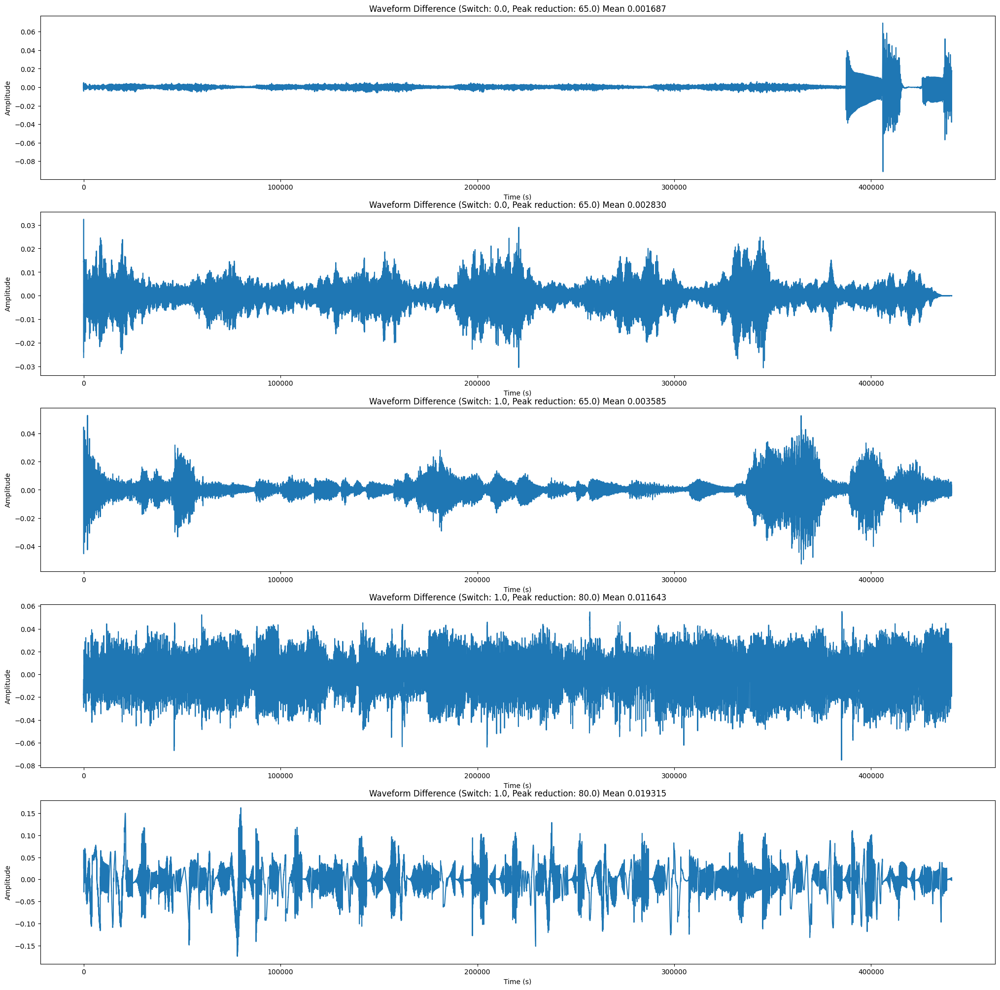

In [9]:
@torch.no_grad()
def evaluate_waveform_difference():
    x, y, cond = testing_dataset.collate_fn([testing_dataset[i] for i in TESTING_DATASET_SAMPLE_INDEX])
    x = x.to(device)
    y = y.to(device)
    cond = cond.to(device)
    
    y_hat: Tensor = model(y, cond)
    
    fig, axes = plt.subplots(5, 1, figsize=(25, 25))
    for i, (y_audio, y_hat_audio, cond_data) in enumerate(zip(
        y.split(1), y_hat.split(1), cond.split(1),
    )):
        print(f'index {i} y audio peak {y_audio.abs().max().item():.6f}')
        print(f'index {i} y audio hat peak {y_hat_audio.abs().max().item():.6f}')
        diff = (y_audio - y_hat_audio).flatten().cpu()
        diff_numpy = diff.numpy()
        display(Audio(diff_numpy, rate=testing_dataset.sample_rate, normalize=False))
        switch, peak_reduction = cond_data.flatten().cpu().tolist()
        ax = axes[i]
        ax.plot(diff_numpy)
        ax.set_title(
            f'Waveform Difference (Switch: {switch}, '
            f'Peak reduction: {peak_reduction}) '
            f'Mean {diff.abs().mean().item():.6f}'
        )
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Amplitude')
    
    fig.show()

evaluate_waveform_difference()

## Evaluate RMS Difference

In [10]:
@torch.no_grad()
def evaluate_rms_difference():
    return NotImplemented
    x, y, cond = testing_dataset.collate_fn([testing_dataset[i] for i in TESTING_DATASET_SAMPLE_INDEX])
    x = x.to(device)
    y = y.to(device)
    cond = cond.to(device)
    
    y_hat: Tensor = model(y, cond)
    
    fig, axes = plt.subplots(5, 1, figsize=(25, 25))
    for i, (y_audio, y_hat_audio, cond_data) in enumerate(zip(
        y.split(1), y_hat.split(1), cond.split(1),
    )):
        diff = (y_audio - y_hat_audio).flatten().cpu()
        switch, peak_reduction = cond_data.flatten().cpu().tolist()
        ax = axes[i]
        ax.plot(diff.numpy())
        ax.set_title(
            f'Waveform Difference (Switch: {switch}, '
            f'Peak reduction: {peak_reduction}) '
            f'Mean {diff.abs().mean().item():.8f}'
        )
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Amplitude')
    
    fig.show()

evaluate_rms_difference()

NotImplemented

## Evaluate STFT Difference

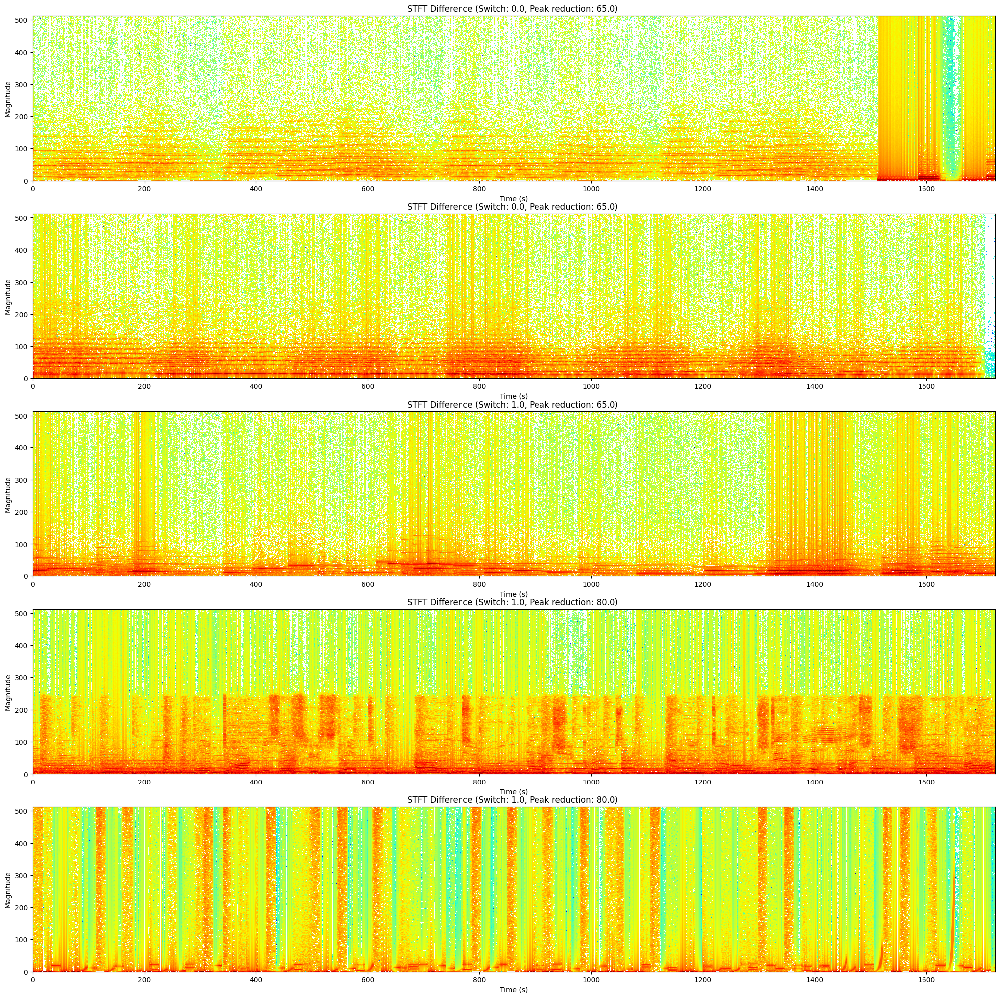

In [11]:
@torch.no_grad()
def evaluate_stft_difference():
    x, y, cond = testing_dataset.collate_fn([testing_dataset[i] for i in TESTING_DATASET_SAMPLE_INDEX])
    x = x.to(device)
    y = y.to(device)
    cond = cond.to(device)
    
    y_hat: Tensor = model(y, cond)
    
    fig, axes = plt.subplots(5, 1, figsize=(25, 25))
    for i, (y_audio, y_hat_audio, cond_data) in enumerate(zip(
        y.split(1), y_hat.split(1), cond.split(1),
    )):
        y_stft = torch.stft(y_audio.flatten(), n_fft=1024, hop_length=256, win_length=1024, return_complex=True)
        y_hat_stft = torch.stft(y_hat_audio.flatten(), n_fft=1024, hop_length=256, win_length=1024, return_complex=True)
        diff = (y_stft.abs() - y_hat_stft.abs()).cpu().log10().mul(10).numpy()
        switch, peak_reduction = cond_data.flatten().cpu().tolist()
        ax = axes[i]
        ax.pcolormesh(diff, cmap='jet')
        ax.set_title(
            f'STFT Difference (Switch: {switch}, '
            f'Peak reduction: {peak_reduction}) '
        )
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Magnitude')
    
    fig.show()

evaluate_stft_difference()

## Evaluate Model Step Response

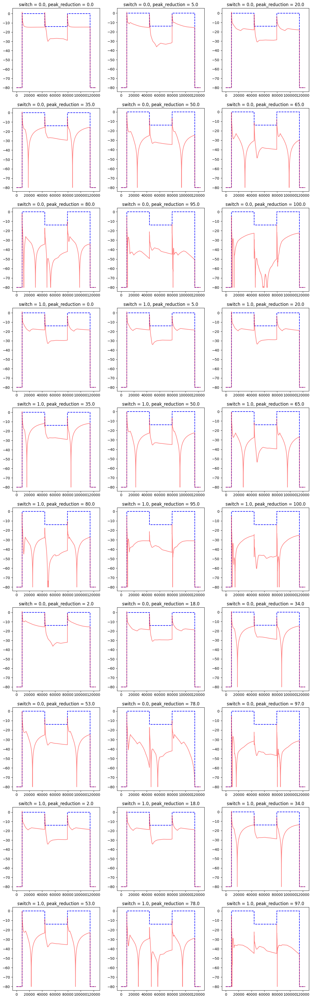

In [12]:
@torch.no_grad()
def evaluate_model_step_response():
    parameter_pair = torch.tensor([
        [0, 0],
        [0, 5],
        [0, 20],
        [0, 35],
        [0, 50],
        [0, 65],
        [0, 80],
        [0, 95],
        [0, 100],
        [1, 0],
        [1, 5],
        [1, 20],
        [1, 35],
        [1, 50],
        [1, 65],
        [1, 80],
        [1, 95],
        [1, 100],
        [0, 2],
        [0, 18],
        [0, 34],
        [0, 53],
        [0, 78],
        [0, 97],
        [1, 2],
        [1, 18],
        [1, 34],
        [1, 53],
        [1, 78],
        [1, 97],
    ]).to(device, torch.float32)
    
    sr = testing_dataset.sample_rate
    step_signal = torch.cat([
        torch.zeros(int(sr * 0.2)),
        torch.ones(int(sr * 0.8)),
        torch.zeros(int(sr * 0.8)) + 0.2,
        torch.ones(int(sr * 0.8)),
        torch.zeros(int(sr * 0.2)),
    ]).to(device, torch.float32)
    output_signals: Tensor = model(
        step_signal.repeat(parameter_pair.size(0), 1),
        parameter_pair,
    )
    step_signal_decibel = convert_to_decibel(step_signal)
    
    fig, axs = plt.subplots(10, 3, figsize=(15, 50))
    for i, output_signal in enumerate(output_signals.split(1)):
        switch, peak_reduction = parameter_pair[i].tolist()
        row, col = divmod(i, 3)
        ax = axs[row][col]
        ax.plot(step_signal_decibel.cpu().numpy(), color='blue', linestyle='dashed', alpha=1.0)
        ax.plot(convert_to_decibel(output_signal).flatten().cpu().numpy(), color='red', linestyle='solid', alpha=0.5)
        ax.set_title(f'{switch = }, {peak_reduction = }')
    fig.show()
    
evaluate_model_step_response()